<a href="https://colab.research.google.com/github/Uniholder/DeepLearningSchool/blob/main/11_CV_usage/catalyst_efficientnet_classification_tutorial_SOLVED.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Catalyst classification tutorial

Authors: [Roman Tezikov](https://github.com/TezRomacH), [Sergey Kolesnikov](https://github.com/Scitator)

[![Catalyst logo](https://raw.githubusercontent.com/catalyst-team/catalyst-pics/master/pics/catalyst_logo.png)](https://github.com/catalyst-team/catalyst)

### Colab setup

First of all, do not forget to change the runtime type to GPU. <br/>
To do so click `Runtime` -> `Change runtime type` -> Select `"Python 3"` and `"GPU"` -> click `Save`. <br/>
After that you can click `Runtime` -> `Run` all and watch the tutorial.

## Requirements

Download and install the latest version of catalyst and other libraries required for this tutorial.

In [1]:
# this variable will be used in `runner.train` and by default we disable FP16 mode
is_fp16_used = False

In [2]:
# for augmentations
!pip install albumentations

# for pretrained models for PyTorch
!pip install pretrainedmodels


################
# Catalyst itself
!pip install -U catalyst
# For specific version of catalyst, uncomment:
# ! pip install git+http://github.com/catalyst-team/catalyst.git@{master/commit_hash}
################

# for TTA
# !pip install ttach

# for tensorboard
!pip install tensorflow
%load_ext tensorboard


# if Your machine support Apex FP16, uncomment this 3 lines below
# !git clone https://github.com/NVIDIA/apex
# !pip install -v --no-cache-dir --global-option="--cpp_ext" --global-option="--cuda_ext" ./apex
# is_fp16_used = True

### Colab extras – Plotly

To intergate visualization library `plotly` to colab, run

In [3]:
import IPython

def configure_plotly_browser_state():
    display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
        <script>
          requirejs.config({
            paths: {
              base: '/static/base',
              plotly: 'https://cdn.plot.ly/plotly-latest.min.js?noext',
            },
          });
        </script>
        '''))


IPython.get_ipython().events.register('pre_run_cell', configure_plotly_browser_state)

## Setting up GPUs

In [4]:
from typing import Callable, List, Tuple 

import os
import torch
import catalyst

from catalyst import utils

print(f"torch: {torch.__version__}, catalyst: {catalyst.__version__}")

# os.environ["CUDA_VISIBLE_DEVICES"] = "0"  # "" - CPU, "0" - 1 GPU, "0,1" - MultiGPU

SEED = 42
utils.set_global_seed(SEED)
utils.prepare_cudnn(deterministic=True)

torch: 1.8.1, catalyst: 21.04.2


-------

## Dataset

As a dataset we will take [Best Artworks of All Time](https://www.kaggle.com/ikarus777/best-artworks-of-all-time) - collection of Paintings of the 50 Most Influential Artists of All Time.

> If you are on MacOS and you don’t have `wget`, you can install it with: `brew install wget`.

After Catalyst installation, `download-gdrive` function become available to download objects from Google Drive.
We use it to download datasets.

usage: `download-gdrive {FILE_ID} {FILENAME}`

In [5]:
!ls -l ../data/

total 4
drwxrwxrwx 52 uniholder uniholder 4096 Aug 12  2019 artworks


In [6]:
# %%bash

# download-gdrive 1eAk36MEMjKPKL5j9VWLvNTVKk4ube9Ml ../data/artworks.tar.gz
# extract-archive ../data/artworks.tar.gz &>/dev/null

In [7]:
from pathlib import Path

ROOT = "../data/artworks/"
ALL_IMAGES = list(Path(ROOT).glob("**/*.jpg"))
ALL_IMAGES = list(filter(lambda x: not x.name.startswith("."), ALL_IMAGES))
print("Number of images:", len(ALL_IMAGES))

Number of images: 8446


Let's check out the data!

In [8]:
from catalyst.utils import imread
import numpy as np

import matplotlib.pyplot as plt

def show_examples(images: List[Tuple[str, np.ndarray]]):
    _indexes = [(i, j) for i in range(2) for j in range(2)]
    
    f, ax = plt.subplots(2, 2, figsize=(16, 16))
    for (i, j), (title, img) in zip(_indexes, images):
        ax[i, j].imshow(img)
        ax[i, j].set_title(title)
    f.tight_layout()

def read_random_images(paths: List[Path]) -> List[Tuple[str, np.ndarray]]:
    data = np.random.choice(paths, size=4)
    result = []
    for d in data:
        title = f"{d.parent.name}: {d.name}"
        _image = imread(d)
        result.append((title, _image))
    
    return result

You can restart the cell below to see more examples.

In [9]:
%matplotlib inline

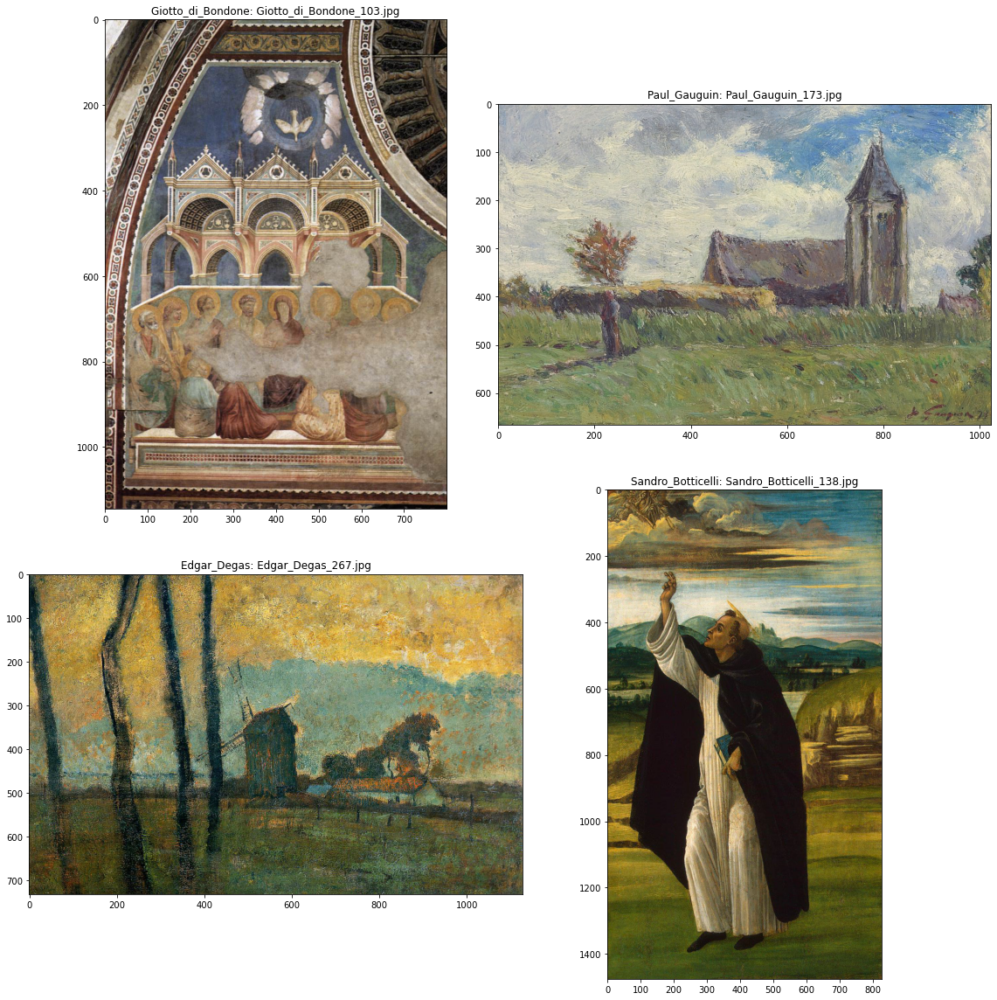

In [10]:
images = read_random_images(ALL_IMAGES)
show_examples(images)

## Dataset preprocessing

With Catalyst we can easily create a dataset from the following folder structure:
```
dataset/
    class_1/
        *.ext
        ...
    class_2/
        *.ext
        ...
    ...
    class_N/
        *.ext
        ...
```

First of all `create_dataset` function goes through a given directory and creates a dictionary `Dict[class_name, List[image]]`. <br/>
Then `create_dataframe` function creates typical `pandas.DataFrame` for further analysis. <br/>
After than `prepare_dataset_labeling` creates a numerical label for each unique class name. <br/>
Finally, to add a column with a numerical label value to the DataFrame, we can use `map_dataframe` function.

Additionaly let's save the `class_names` for further usage.

In [11]:
# from catalyst.utils.dataset import create_dataset, create_dataframe, prepare_dataset_labeling
# from catalyst.utils.pandas import map_dataframe

from catalyst.contrib.utils.pandas import create_dataset, create_dataframe, get_dataset_labeling, map_dataframe

dataset = create_dataset(dirs=f"{ROOT}/*", extension="*.jpg")
df = create_dataframe(dataset, columns=["class", "filepath"])

tag_to_label = get_dataset_labeling(df, "class")
# tag_to_label = {k: i for i, k in enumerate(sorted(np.unique(df['class'])))} 
class_names = [name for name, id_ in sorted(tag_to_label.items(), key=lambda x: x[1])]

df_with_labels = map_dataframe(
    df, 
    tag_column="class", 
    class_column="label", 
    tag2class=tag_to_label, 
    verbose=False
)
df_with_labels.head()

,class,filepath,label
0,Albrecht_Dürer,../data/artworks/Albrecht_Dürer/Albrecht_Dür...,0
1,Albrecht_Dürer,../data/artworks/Albrecht_Dürer/Albrecht_Dür...,0
2,Albrecht_Dürer,../data/artworks/Albrecht_Dürer/Albrecht_Dür...,0
3,Albrecht_Dürer,../data/artworks/Albrecht_Dürer/Albrecht_Dür...,0
4,Albrecht_Dürer,../data/artworks/Albrecht_Dürer/Albrecht_Dür...,0


Now let's divide our dataset into the `train` and` valid` parts. <br/>
The parameters for the split_dataframe function are the same as [sklearn.train_test_split](https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.train_test_split.html#sklearn-model-selection-train-test-split). <br/>
We also define `test_size` (it is optional) and `random_state` for reproducibility.

In [12]:
# from catalyst.utils.dataset import split_dataframe
from catalyst.contrib.utils.pandas import split_dataframe_train_test

train_data, valid_data = split_dataframe_train_test(df_with_labels, test_size=0.2, random_state=SEED)
train_data, valid_data = train_data.to_dict('records'), valid_data.to_dict('records')

In order to save your time during data preparation/reading/writing, Catalyst provides a special abstraction – [Reader](https://catalyst-team.github.io/catalyst/api/data.html#reader). <br/> 
Reader allows you to read various structures, for example, images, strings, numerical values and perform some functions on top of them.

In [13]:
# from catalyst.data.reader import ImageReader, ScalarReader, ReaderCompose
from catalyst.contrib.data.cv.reader import ImageReader
from catalyst.contrib.data.reader import ScalarReader, ReaderCompose

num_classes = len(tag_to_label)

# ReaderCompose collects different Readers into one pipeline
open_fn = ReaderCompose([
    
    # Reads images from the `datapath` folder 
    # using the key `input_key =" filepath "` (here should be the filename)
    # and writes it to the output dictionary by `output_key="features"` key
    ImageReader(
        input_key="filepath",
        output_key="features",
        rootpath=ROOT
    ),
    
    # Reads a number from our dataframe 
    # by the key `input_key =" label "` to np.long
    # and writes it to the output dictionary by `output_key="targets"` key
    ScalarReader(
        input_key="label",
        output_key="targets",
        default_value=-1,
        dtype=np.int64
    ),
    
    # Same as above, but with one encoding
    ScalarReader(
        input_key="label",
        output_key="targets_one_hot",
        default_value=-1,
        dtype=np.int64, 
        one_hot_classes=num_classes
    )
])

-------

## Augmentations

[![Albumentation logo](https://albumentations.readthedocs.io/en/latest/_static/logo.png)](https://github.com/albu/albumentations)

The [albumentation](https://github.com/albu/albumentations) library works with images and masks at the same time, which is what we need.

In [14]:
import albumentations as albu
from albumentations.pytorch import ToTensor

BORDER_CONSTANT = 0
BORDER_REFLECT = 2

def pre_transforms(image_size=224):
    # Convert the image to a square of size image_size x image_size
    # (keeping aspect ratio)
    result = [
        albu.LongestMaxSize(max_size=image_size),
        albu.PadIfNeeded(image_size, image_size, border_mode=BORDER_CONSTANT)
    ]
    
    return result

def hard_transforms():
    result = [
        # Random shifts, stretches and turns with a 50% probability
        albu.ShiftScaleRotate( 
            shift_limit=0.1,
            scale_limit=0.1,
            rotate_limit=15,
            border_mode=BORDER_REFLECT,
            p=0.5
        ),
        albu.IAAPerspective(scale=(0.02, 0.05), p=0.3),
        # Random brightness / contrast with a 30% probability
        albu.RandomBrightnessContrast(
            brightness_limit=0.2, contrast_limit=0.2, p=0.3
        ),
        # Random gamma changes with a 30% probability
        albu.RandomGamma(gamma_limit=(85, 115), p=0.3),
        # Randomly changes the hue, saturation, and color value of the input image
        albu.HueSaturationValue(p=0.3),
        albu.JpegCompression(quality_lower=80),
    ]
    
    return result

def post_transforms():
    # we use ImageNet image normalization
    # and convert it to torch.Tensor
    return [albu.Normalize(), ToTensor()]

def compose(transforms_to_compose):
    # combine all augmentations into one single pipeline
    result = albu.Compose([
      item for sublist in transforms_to_compose for item in sublist
    ])
    return result

Like Reader, there is a close abstraction for handling augmentations and key-value-based dataloaders – [Augmentor](https://catalyst-team.github.io/catalyst/api/data.html#augmentor).

In [15]:
# from catalyst.data.augmentor import Augmentor
from catalyst.contrib.data.augmentor import Augmentor


train_transforms = compose([
    pre_transforms(), 
    hard_transforms(), 
    post_transforms()
])
valid_transforms = compose([pre_transforms(), post_transforms()])

show_transforms = compose([pre_transforms(), hard_transforms()])

# Takes an image from the input dictionary by the key `dict_key` 
# and performs `train_transforms` on it.
train_data_transforms = Augmentor(
    dict_key="features",
    augment_fn=lambda x: train_transforms(image=x)["image"]
)


# Similarly for the validation part of the dataset. 
# we only perform squaring, normalization and ToTensor
valid_data_transforms = Augmentor(
    dict_key="features",
    augment_fn=lambda x: valid_transforms(image=x)["image"]
)

Let's look at the augmented results. <br/>
You can restart the cell below to see more examples of augmentations.

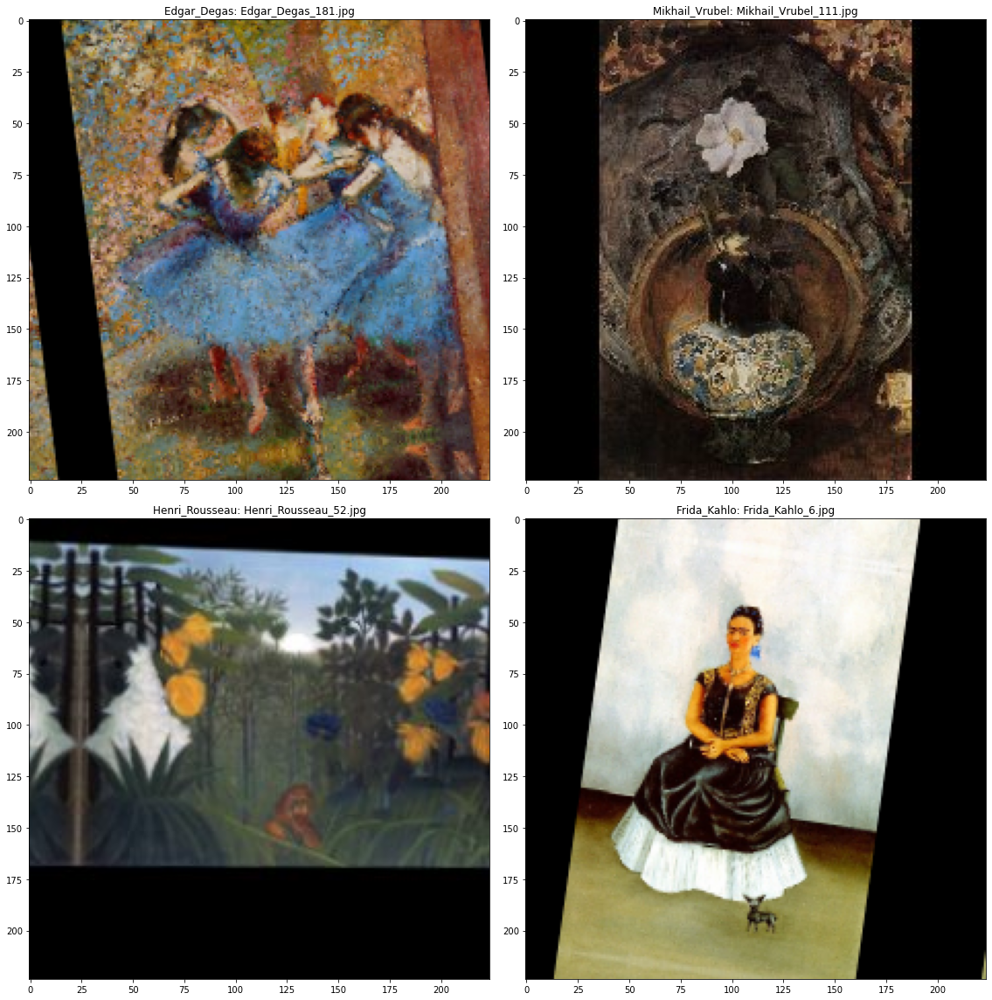

In [16]:
images = read_random_images(ALL_IMAGES)

images = [
    (title, show_transforms(image=i)["image"])
    for (title, i) in images
]
show_examples(images)

-------

## Loaders

Using `catalyst.utils.get_loader`, you can immediately get loaders only from the dataset and data-converting functions.

In [17]:
import collections
# from catalyst.dl import utils

def get_loaders(
    open_fn: Callable,
    train_transforms_fn,
    valid_transforms_fn,
    batch_size: int = 64, 
    num_workers: int = 4,
    sampler = None
) -> collections.OrderedDict:
    """
    Args:
        open_fn: Reader for reading data from a dataframe
        train_transforms_fn: Augmentor for train part
        valid_transforms_fn: Augmentor for valid part
        batch_size: batch size
        num_workers: How many subprocesses to use to load data,
        sampler: An object of the torch.utils.data.Sampler class 
            for the dataset data sampling strategy specification
    """
    train_loader = utils.get_loader(
        train_data,
        open_fn=open_fn,
        dict_transform=train_transforms_fn,
        batch_size=batch_size,
        num_workers=num_workers,
        shuffle=sampler is None, # shuffle data only if Sampler is not specified (PyTorch requirement)
        sampler=sampler,
        drop_last=True,
    )

    valid_loader = utils.get_loader(
        valid_data,
        open_fn=open_fn,
        dict_transform=valid_transforms_fn,
        batch_size=batch_size,
        num_workers=num_workers,
        shuffle=False, 
        sampler=None,
        drop_last=True,
    )

    # Catalyst expects an ordered dictionary with train/valid/infer loaders. 
    # The number of loaders can vary.
    # For example, it can easily handle even some complex logic like:
    # loaders["train_dataset1"] = train_loader_1
    # loaders["train_dataset2"] = train_loader_2
    # ....
    # loaders["valid_1"] = valid_loader_1
    # loaders["valid_2"] = valid_loader_2
    # ...
    # loaders["infer_1"] = infer_loader_1
    # loaders["infer_2"] = infer_loader_2
    # ...
    
    loaders = collections.OrderedDict()
    loaders["train"] = train_loader
    loaders["valid"] = valid_loader

    return loaders

if is_fp16_used:
    batch_size = 64 # 128
else:
    batch_size = 32 # 64

print(f"batch_size: {batch_size}")

loaders = get_loaders(
    open_fn=open_fn, 
    train_transforms_fn=train_data_transforms,
    valid_transforms_fn=valid_data_transforms,
    batch_size=batch_size,
    num_workers=2 # for colab
)


batch_size: 32


-------

## Experiment
### Model

Let's take the classification model from [Cadene pretrain models](https://github.com/Cadene/pretrained-models.pytorch). This repository contains a huge number of pre-trained PyTorch models.

**> Мы вместо этого используем [EfficientNet-PyTorch](https://github.com/lukemelas/EfficientNet-PyTorch)**

In [18]:
!pip install --upgrade efficientnet-pytorch

In [19]:
from torch import nn
# import pretrainedmodels
from efficientnet_pytorch import EfficientNet

def get_model(model_name: str, num_classes: int, pretrained: str = "imagenet"):
    # model_fn = pretrainedmodels.__dict__[model_name]
    # model = model_fn(num_classes=1000, pretrained=pretrained)
    
    # model._fc = nn.Sequential()
    # dim_feats = model.last_linear.in_features
    # model.last_linear = nn.Linear(dim_feats, num_classes)

    model = EfficientNet.from_pretrained(model_name, num_classes=num_classes) #.cuda()

    return model

model_name = 'efficientnet-b1'
model = get_model(model_name, num_classes)
model

Loaded pretrained weights for efficientnet-b1


EfficientNet(
  (_conv_stem): Conv2dStaticSamePadding(
    3, 32, kernel_size=(3, 3), stride=(2, 2), bias=False
    (static_padding): ZeroPad2d(padding=(0, 1, 0, 1), value=0.0)
  )
  (_bn0): BatchNorm2d(32, eps=0.001, momentum=0.010000000000000009, affine=True, track_running_stats=True)
  (_blocks): ModuleList(
    (0): MBConvBlock(
      (_depthwise_conv): Conv2dStaticSamePadding(
        32, 32, kernel_size=(3, 3), stride=[1, 1], groups=32, bias=False
        (static_padding): ZeroPad2d(padding=(1, 1, 1, 1), value=0.0)
      )
      (_bn1): BatchNorm2d(32, eps=0.001, momentum=0.010000000000000009, affine=True, track_running_stats=True)
      (_se_reduce): Conv2dStaticSamePadding(
        32, 8, kernel_size=(1, 1), stride=(1, 1)
        (static_padding): Identity()
      )
      (_se_expand): Conv2dStaticSamePadding(
        8, 32, kernel_size=(1, 1), stride=(1, 1)
        (static_padding): Identity()
      )
      (_project_conv): Conv2dStaticSamePadding(
        32, 16, kernel_size=

### Model training

In [20]:
import torch

# as we are working on basic classification problem (no multi-class/multi-label)
# let's use standard CE loss
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.0003)
scheduler = torch.optim.lr_scheduler.MultiStepLR(
    optimizer, milestones=[9], gamma=0.3
)

To run some DL experiment, Catalyst uses a [Runner](https://catalyst-team.github.io/catalyst/api/dl.html#catalyst.dl.core.runner.Runner) abstraction. <br/>
It contains main logic about "how" you run the experiment and getting predictions.

For supervised learning case, there is an extention for Runner – [SupervisedRunner](https://catalyst-team.github.io/catalyst/api/dl.html#module-catalyst.dl.runner.supervised), which provides additional methods like `train`, `infer` and `predict_loader`.

In [21]:
# from catalyst.dl.runner import SupervisedRunner
from catalyst.runners.runner import SupervisedRunner

num_epochs = 10
logdir = "./logs/classification"

device = utils.get_device()
print(f"device: {device}")

if is_fp16_used:
    fp16_params = dict(opt_level="O1") # params for FP16
else:
    fp16_params = None

print(f"FP16 params: {fp16_params}")

runner = SupervisedRunner(engine=device)

device: cuda
FP16 params: None


Using [Callbacks](https://catalyst-team.github.io/catalyst/api/dl.html#catalyst.dl.core.callback.Callback), the basic functionality of the catalyst can be expanded.

A callback is a class inherited from `catalyst.dl.core.Callback` and implements one / several / all methods:

```
on_stage_start
    --- on_epoch_start
    ------ on_loader_start
    --------- on_batch_start
    --------- on_batch_end
    ------ on_loader_end
    --- on_epoch_end
on_stage_end

on_exception - if the code crashes with an error, you can catch it and reserve the parameters you need
```

You can find the list of standard callbacks [here](https://catalyst-team.github.io/catalyst/api/dl.html#module-catalyst.dl.callbacks.checkpoint). 
It includes callbacks such as
- CheckpointCallback. Saves N best models in logdir
- TensorboardLogger. Logs all metrics to tensorboard
- EarlyStoppingCallback. Early training stop if metrics do not improve for the `patience` of epochs
- ConfusionMatrixCallback. Plots ConfusionMatrix per epoch in tensorboard

Many different metrics for classfication
- AccuracyCallback
- MapKCallback
- AUCCallback
- F1ScoreCallback

segmentation
- DiceCallback
- IouCallback

and many other callbacks, like LRFinder and MixupCallback

### Monitoring in tensorboard

If you do not have a Tensorboard opened after you have run the cell below, try running the cell again.

In [22]:
%tensorboard --logdir {logdir}

### Running train-loop

In [26]:
runner.epoch_metrics

defaultdict(None,
            {'_epoch_': {'lr': 8.999999999999999e-05, 'momentum': 0.9},
             'train': {'accuracy01': 0.9653435945510864,
              'accuracy03': 0.9955568909645081,
              'accuracy05': 0.9986670613288879,
              'accuracy': 0.9653435945510864,
              'accuracy01/std': 0.02969479580967565,
              'accuracy03/std': 0.011731998164920716,
              'accuracy05/std': 0.0070100923342345444,
              'accuracy/std': 0.02969479580967565,
              'auc/class_00': 0.9999047517776489,
              'auc/class_01': 0.9990254640579224,
              'auc/class_02': 0.9999949932098389,
              'auc/class_03': 0.9997889995574951,
              'auc/class_04': 0.9994927048683167,
              'auc/class_05': 0.9969099760055542,
              'auc/class_06': 0.999582052230835,
              'auc/class_07': 0.995467483997345,
              'auc/class_08': 0.9934960007667542,
              'auc/class_09': 0.9983689188957214,


In [24]:
# as we are working on classification task
# from catalyst.dl.callbacks import AccuracyCallback, AUCCallback, F1ScoreCallback
from catalyst.callbacks.metrics.accuracy import AccuracyCallback
from catalyst.callbacks.metrics.auc import AUCCallback
from catalyst.callbacks.metrics.classification import PrecisionRecallF1SupportCallback

runner.train(
    model=model,
    criterion=criterion,
    optimizer=optimizer,
    scheduler=scheduler,
    loaders=loaders,
    # We can specify the callbacks list for the experiment;
    # For this task, we will check accuracy, AUC and F1 metrics
    callbacks=[
        AccuracyCallback(
            input_key='logits',
            target_key='targets',
            num_classes=num_classes
        ),
        AUCCallback(
            input_key='logits',
            target_key='targets'
            # num_classes=num_classes,
            # class_names=class_names
        ),
        PrecisionRecallF1SupportCallback(
            input_key='logits',
            target_key='targets',
            num_classes=num_classes
            # activation="Softmax"
        )
    ],
    # path to save logs
    logdir=logdir,
    
    num_epochs=num_epochs,
    
    # save our best checkpoint by AUC metric
    valid_loader='valid',
    valid_metric="auc", # /_mean
    # AUC needs to be maximized.
    minimize_valid_metric=False,
    
    # for FP16. It uses the variable from the very first cell
    fp16=fp16_params,
    
    # prints train logs
    verbose=True
)

1/10 * Epoch (train):   0%|          | 0/211 [00:00<?, ?it/s]

/home/uniholder/anaconda3/lib/python3.8/site-packages/catalyst/core/runner.py:716: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  k: runner.engine.sync_tensor(torch.tensor(v, device=runner.device), "mean")


train (1/10) accuracy: 0.3712973892688751 | accuracy/std: 0.15029777623971866 | accuracy01: 0.3712973892688751 | accuracy01/std: 0.15029777623971866 | accuracy03: 0.5767180323600769 | accuracy03/std: 0.17271481125619276 | accuracy05: 0.6679502129554749 | accuracy05/std: 0.16997408956726837 | auc: 0.8342739939689636 | auc/_macro: 0.8342739939689636 | auc/_micro: 0.8831508105059283 | auc/_weighted: 0.8563022017478943 | auc/class_00: 0.9705119132995605 | auc/class_01: 0.9448134303092957 | auc/class_02: 0.9267633557319641 | auc/class_03: 0.8506859540939331 | auc/class_04: 0.9239187240600586 | auc/class_05: 0.8561978340148926 | auc/class_06: 0.8908889889717102 | auc/class_07: 0.8402213454246521 | auc/class_08: 0.6924971342086792 | auc/class_09: 0.842242956161499 | auc/class_10: 0.8966670632362366 | auc/class_11: 0.7116806507110596 | auc/class_12: 0.7222480773925781 | auc/class_13: 0.8606020212173462 | auc/class_14: 0.6968910694122314 | auc/class_15: 0.8707379698753357 | auc/class_16: 0.8317

1/10 * Epoch (valid):   0%|          | 0/52 [00:00<?, ?it/s]

valid (1/10) accuracy: 0.5727163553237915 | accuracy/std: 0.09784224086889523 | accuracy01: 0.5727163553237915 | accuracy01/std: 0.09784224086889523 | accuracy03: 0.7590144276618958 | accuracy03/std: 0.07810917030526184 | accuracy05: 0.8335336446762085 | accuracy05/std: 0.07035932222900333 | auc: 0.9404654502868652 | auc/_macro: 0.9404654502868652 | auc/_micro: 0.9521338881220942 | auc/_weighted: 0.9475287199020386 | auc/class_00: 0.996074378490448 | auc/class_01: 0.9924234747886658 | auc/class_02: 0.9982567429542542 | auc/class_03: 0.9580464363098145 | auc/class_04: 0.9773392677307129 | auc/class_05: 0.9545698165893555 | auc/class_06: 0.9088744521141052 | auc/class_07: 0.9744266867637634 | auc/class_08: 0.9628729820251465 | auc/class_09: 0.8973732590675354 | auc/class_10: 0.9695170521736145 | auc/class_11: 0.8969249129295349 | auc/class_12: 0.8956310749053955 | auc/class_13: 0.9535800814628601 | auc/class_14: 0.8737951517105103 | auc/class_15: 0.9524449110031128 | auc/class_16: 0.9472

* Epoch (1/10) lr: 0.0003 | momentum: 0.9


2/10 * Epoch (train):   0%|          | 0/211 [00:00<?, ?it/s]

train (2/10) accuracy: 0.6395142078399658 | accuracy/std: 0.08772424057295548 | accuracy01: 0.6395142078399658 | accuracy01/std: 0.08772424057295548 | accuracy03: 0.8225710988044739 | accuracy03/std: 0.06803924416375408 | accuracy05: 0.891883909702301 | accuracy05/std: 0.05726411556585605 | auc: 0.9534565806388855 | auc/_macro: 0.9534565806388855 | auc/_micro: 0.9668208363871451 | auc/_weighted: 0.9586440920829773 | auc/class_00: 0.993982195854187 | auc/class_01: 0.987644612789154 | auc/class_02: 0.9930891394615173 | auc/class_03: 0.9739780426025391 | auc/class_04: 0.9857904314994812 | auc/class_05: 0.9383574724197388 | auc/class_06: 0.9596512317657471 | auc/class_07: 0.9345749616622925 | auc/class_08: 0.9174885153770447 | auc/class_09: 0.9388048648834229 | auc/class_10: 0.9743925929069519 | auc/class_11: 0.9013899564743042 | auc/class_12: 0.9206088781356812 | auc/class_13: 0.9755269885063171 | auc/class_14: 0.9315544366836548 | auc/class_15: 0.9511399269104004 | auc/class_16: 0.969607

2/10 * Epoch (valid):   0%|          | 0/52 [00:00<?, ?it/s]

valid (2/10) accuracy: 0.6700721383094788 | accuracy/std: 0.08764933599928043 | accuracy01: 0.6700721383094788 | accuracy01/std: 0.08764933599928043 | accuracy03: 0.8521634340286255 | accuracy03/std: 0.06938962275815647 | accuracy05: 0.9116586446762085 | accuracy05/std: 0.057744081106352076 | auc: 0.9661837220191956 | auc/_macro: 0.9661837220191956 | auc/_micro: 0.9738516206975116 | auc/_weighted: 0.9685991406440735 | auc/class_00: 0.9975243806838989 | auc/class_01: 0.9942903518676758 | auc/class_02: 0.9980614185333252 | auc/class_03: 0.9891993999481201 | auc/class_04: 0.9860913753509521 | auc/class_05: 0.9716418385505676 | auc/class_06: 0.929177463054657 | auc/class_07: 0.9888357520103455 | auc/class_08: 0.959767758846283 | auc/class_09: 0.9492748975753784 | auc/class_10: 0.985363245010376 | auc/class_11: 0.9125683307647705 | auc/class_12: 0.9517596960067749 | auc/class_13: 0.9946905374526978 | auc/class_14: 0.8783132433891296 | auc/class_15: 0.9786897301673889 | auc/class_16: 0.98730

* Epoch (2/10) lr: 0.0003 | momentum: 0.9


3/10 * Epoch (train):   0%|          | 0/211 [00:00<?, ?it/s]

train (3/10) accuracy: 0.7539988160133362 | accuracy/std: 0.06889985733488489 | accuracy01: 0.7539988160133362 | accuracy01/std: 0.06889985733488489 | accuracy03: 0.9086196422576904 | accuracy03/std: 0.05122132322773928 | accuracy05: 0.9483116269111633 | accuracy05/std: 0.03520471979588833 | auc: 0.9769744873046875 | auc/_macro: 0.9769744873046875 | auc/_micro: 0.9835365246906522 | auc/_weighted: 0.9783626794815063 | auc/class_00: 0.99772047996521 | auc/class_01: 0.9909501075744629 | auc/class_02: 0.9965161681175232 | auc/class_03: 0.9915499091148376 | auc/class_04: 0.9952871203422546 | auc/class_05: 0.958093523979187 | auc/class_06: 0.9862766265869141 | auc/class_07: 0.9517923593521118 | auc/class_08: 0.9564179182052612 | auc/class_09: 0.958753764629364 | auc/class_10: 0.9879190325737 | auc/class_11: 0.9603028893470764 | auc/class_12: 0.964655339717865 | auc/class_13: 0.9897999167442322 | auc/class_14: 0.9646647572517395 | auc/class_15: 0.9731742143630981 | auc/class_16: 0.99639111757

3/10 * Epoch (valid):   0%|          | 0/52 [00:00<?, ?it/s]

valid (3/10) accuracy: 0.7229567170143127 | accuracy/std: 0.07803511122343114 | accuracy01: 0.7229567170143127 | accuracy01/std: 0.07803511122343114 | accuracy03: 0.8725961446762085 | accuracy03/std: 0.059704043660840686 | accuracy05: 0.9194711446762085 | accuracy05/std: 0.04722697981026488 | auc: 0.9730943441390991 | auc/_macro: 0.9730943441390991 | auc/_micro: 0.9782081496210262 | auc/_weighted: 0.9745301604270935 | auc/class_00: 0.9988152384757996 | auc/class_01: 0.9937881231307983 | auc/class_02: 0.9995942711830139 | auc/class_03: 0.9935534000396729 | auc/class_04: 0.9824432134628296 | auc/class_05: 0.9795706868171692 | auc/class_06: 0.948354959487915 | auc/class_07: 0.9942253828048706 | auc/class_08: 0.9696908593177795 | auc/class_09: 0.9725106954574585 | auc/class_10: 0.9886471629142761 | auc/class_11: 0.9396407008171082 | auc/class_12: 0.9481189250946045 | auc/class_13: 0.9984830021858215 | auc/class_14: 0.9079819321632385 | auc/class_15: 0.9736350774765015 | auc/class_16: 0.987

* Epoch (3/10) lr: 0.0003 | momentum: 0.9


4/10 * Epoch (train):   0%|          | 0/211 [00:00<?, ?it/s]

train (4/10) accuracy: 0.8243483304977417 | accuracy/std: 0.06903822497279836 | accuracy01: 0.8243483304977417 | accuracy01/std: 0.06903822497279836 | accuracy03: 0.943276047706604 | accuracy03/std: 0.04501679834640974 | accuracy05: 0.9708234667778015 | accuracy05/std: 0.029426885218962213 | auc: 0.9858390688896179 | auc/_macro: 0.9858390688896179 | auc/_micro: 0.9898039778665555 | auc/_weighted: 0.9867839217185974 | auc/class_00: 0.9977336525917053 | auc/class_01: 0.9909892082214355 | auc/class_02: 0.9988247752189636 | auc/class_03: 0.9957268238067627 | auc/class_04: 0.9980292320251465 | auc/class_05: 0.976109504699707 | auc/class_06: 0.9945811629295349 | auc/class_07: 0.9693162441253662 | auc/class_08: 0.9759299755096436 | auc/class_09: 0.978732705116272 | auc/class_10: 0.991482675075531 | auc/class_11: 0.9783558249473572 | auc/class_12: 0.9673651456832886 | auc/class_13: 0.9959956407546997 | auc/class_14: 0.977276623249054 | auc/class_15: 0.9829525351524353 | auc/class_16: 0.9952926

4/10 * Epoch (valid):   0%|          | 0/52 [00:00<?, ?it/s]

valid (4/10) accuracy: 0.734375 | accuracy/std: 0.07318150156136254 | accuracy01: 0.734375 | accuracy01/std: 0.07318150156136254 | accuracy03: 0.8864182829856873 | accuracy03/std: 0.04464265064412737 | accuracy05: 0.9308894276618958 | accuracy05/std: 0.03941494609731913 | auc: 0.9743257164955139 | auc/_macro: 0.9743257164955139 | auc/_micro: 0.9801912725785117 | auc/_weighted: 0.9767590761184692 | auc/class_00: 0.9977896213531494 | auc/class_01: 0.9975000023841858 | auc/class_02: 0.9994890689849854 | auc/class_03: 0.9938234090805054 | auc/class_04: 0.9884591698646545 | auc/class_05: 0.9749991297721863 | auc/class_06: 0.9306060671806335 | auc/class_07: 0.9907056093215942 | auc/class_08: 0.966045618057251 | auc/class_09: 0.9795470237731934 | auc/class_10: 0.9887523651123047 | auc/class_11: 0.9583556652069092 | auc/class_12: 0.9853610396385193 | auc/class_13: 0.9955248832702637 | auc/class_14: 0.833734929561615 | auc/class_15: 0.976571798324585 | auc/class_16: 0.9966616034507751 | auc/cla

* Epoch (4/10) lr: 0.0003 | momentum: 0.9


5/10 * Epoch (train):   0%|          | 0/211 [00:00<?, ?it/s]

train (5/10) accuracy: 0.8704087734222412 | accuracy/std: 0.0590171836533024 | accuracy01: 0.8704087734222412 | accuracy01/std: 0.0590171836533024 | accuracy03: 0.9669727683067322 | accuracy03/std: 0.02897082485712285 | accuracy05: 0.9866706132888794 | accuracy05/std: 0.019673137985696684 | auc: 0.9921682476997375 | auc/_macro: 0.9921682476997375 | auc/_micro: 0.9942000931277719 | auc/_weighted: 0.9923267364501953 | auc/class_00: 0.9982962012290955 | auc/class_01: 0.9968801736831665 | auc/class_02: 0.9982755184173584 | auc/class_03: 0.9977717995643616 | auc/class_04: 0.9987108707427979 | auc/class_05: 0.9824231266975403 | auc/class_06: 0.9945048093795776 | auc/class_07: 0.9771372675895691 | auc/class_08: 0.9823479056358337 | auc/class_09: 0.9869107007980347 | auc/class_10: 0.9950498342514038 | auc/class_11: 0.9897880554199219 | auc/class_12: 0.9891178011894226 | auc/class_13: 0.996664822101593 | auc/class_14: 0.9844967722892761 | auc/class_15: 0.9910097718238831 | auc/class_16: 0.99579

5/10 * Epoch (valid):   0%|          | 0/52 [00:00<?, ?it/s]

valid (5/10) accuracy: 0.753004789352417 | accuracy/std: 0.06861189605264487 | accuracy01: 0.753004789352417 | accuracy01/std: 0.06861189605264487 | accuracy03: 0.8978365659713745 | accuracy03/std: 0.050966081999783176 | accuracy05: 0.9368990659713745 | accuracy05/std: 0.04525367158163504 | auc: 0.9745325446128845 | auc/_macro: 0.9745325446128845 | auc/_micro: 0.9805769932441356 | auc/_weighted: 0.97756028175354 | auc/class_00: 0.9986472725868225 | auc/class_01: 0.9963973164558411 | auc/class_02: 0.9997295141220093 | auc/class_03: 0.9946672320365906 | auc/class_04: 0.9879154562950134 | auc/class_05: 0.9841423034667969 | auc/class_06: 0.9062337875366211 | auc/class_07: 0.9920805096626282 | auc/class_08: 0.9537599682807922 | auc/class_09: 0.9723296761512756 | auc/class_10: 0.9887953400611877 | auc/class_11: 0.9415693283081055 | auc/class_12: 0.9782311916351318 | auc/class_13: 0.9973073601722717 | auc/class_14: 0.8575301170349121 | auc/class_15: 0.9745630621910095 | auc/class_16: 0.984818

* Epoch (5/10) lr: 0.0003 | momentum: 0.9


6/10 * Epoch (train):   0%|          | 0/211 [00:00<?, ?it/s]

train (6/10) accuracy: 0.9035841226577759 | accuracy/std: 0.054022074820551554 | accuracy01: 0.9035841226577759 | accuracy01/std: 0.054022074820551554 | accuracy03: 0.9808945655822754 | accuracy03/std: 0.025102801286204037 | accuracy05: 0.9928910136222839 | accuracy05/std: 0.014121527327834673 | auc: 0.9946640133857727 | auc/_macro: 0.9946640133857727 | auc/_micro: 0.9960218157017098 | auc/_weighted: 0.9947474002838135 | auc/class_00: 0.9992128014564514 | auc/class_01: 0.9968072772026062 | auc/class_02: 0.999546468257904 | auc/class_03: 0.9987767338752747 | auc/class_04: 0.9987031817436218 | auc/class_05: 0.9896938800811768 | auc/class_06: 0.9988079071044922 | auc/class_07: 0.9795482158660889 | auc/class_08: 0.9856544137001038 | auc/class_09: 0.9916265606880188 | auc/class_10: 0.9965238571166992 | auc/class_11: 0.993963897228241 | auc/class_12: 0.9797922968864441 | auc/class_13: 0.9991127252578735 | auc/class_14: 0.9911080002784729 | auc/class_15: 0.9911395907402039 | auc/class_16: 0.9

6/10 * Epoch (valid):   0%|          | 0/52 [00:00<?, ?it/s]

valid (6/10) accuracy: 0.7433894276618958 | accuracy/std: 0.06863296041604008 | accuracy01: 0.7433894276618958 | accuracy01/std: 0.06863296041604008 | accuracy03: 0.887620210647583 | accuracy03/std: 0.049143144832498646 | accuracy05: 0.9314903616905212 | accuracy05/std: 0.03974818395314392 | auc: 0.9738882184028625 | auc/_macro: 0.9738882184028625 | auc/_micro: 0.9801025169509835 | auc/_weighted: 0.9776982665061951 | auc/class_00: 0.9993899464607239 | auc/class_01: 0.9955894947052002 | auc/class_02: 0.9998046159744263 | auc/class_03: 0.9959835410118103 | auc/class_04: 0.9860387444496155 | auc/class_05: 0.9735347628593445 | auc/class_06: 0.9222511053085327 | auc/class_07: 0.9904305934906006 | auc/class_08: 0.9559201002120972 | auc/class_09: 0.9770582914352417 | auc/class_10: 0.9892399311065674 | auc/class_11: 0.8730311989784241 | auc/class_12: 0.9888122081756592 | auc/class_13: 0.9919599294662476 | auc/class_14: 0.8882530331611633 | auc/class_15: 0.9705128073692322 | auc/class_16: 0.991

* Epoch (6/10) lr: 0.0003 | momentum: 0.9


7/10 * Epoch (train):   0%|          | 0/211 [00:00<?, ?it/s]

train (7/10) accuracy: 0.929206132888794 | accuracy/std: 0.0467987889951665 | accuracy01: 0.929206132888794 | accuracy01/std: 0.0467987889951665 | accuracy03: 0.9869668483734131 | accuracy03/std: 0.020781575510942084 | accuracy05: 0.9951125383377075 | accuracy05/std: 0.01323457481445385 | auc: 0.9962303638458252 | auc/_macro: 0.9962303638458252 | auc/_micro: 0.9971248430429978 | auc/_weighted: 0.9960016012191772 | auc/class_00: 0.9995812177658081 | auc/class_01: 0.9981963038444519 | auc/class_02: 0.999808132648468 | auc/class_03: 0.9985213279724121 | auc/class_04: 0.9990522265434265 | auc/class_05: 0.9893579483032227 | auc/class_06: 0.9981861114501953 | auc/class_07: 0.9891074895858765 | auc/class_08: 0.9952210187911987 | auc/class_09: 0.9922489523887634 | auc/class_10: 0.9972257614135742 | auc/class_11: 0.9942141175270081 | auc/class_12: 0.9987622499465942 | auc/class_13: 0.9979817867279053 | auc/class_14: 0.9912983775138855 | auc/class_15: 0.9979327321052551 | auc/class_16: 0.9989780

7/10 * Epoch (valid):   0%|          | 0/52 [00:00<?, ?it/s]

valid (7/10) accuracy: 0.7475961446762085 | accuracy/std: 0.07092458969611741 | accuracy01: 0.7475961446762085 | accuracy01/std: 0.07092458969611741 | accuracy03: 0.8930288553237915 | accuracy03/std: 0.040824592998540216 | accuracy05: 0.9338942170143127 | accuracy05/std: 0.039088112873594594 | auc: 0.9754723906517029 | auc/_macro: 0.9754723906517029 | auc/_micro: 0.9801520172660871 | auc/_weighted: 0.976898193359375 | auc/class_00: 0.999168872833252 | auc/class_01: 0.9968012571334839 | auc/class_02: 0.9997295141220093 | auc/class_03: 0.9894356727600098 | auc/class_04: 0.985723078250885 | auc/class_05: 0.979820728302002 | auc/class_06: 0.8808225393295288 | auc/class_07: 0.9923005104064941 | auc/class_08: 0.9531861543655396 | auc/class_09: 0.983257532119751 | auc/class_10: 0.9842351078987122 | auc/class_11: 0.9667130708694458 | auc/class_12: 0.9905946850776672 | auc/class_13: 0.9866125583648682 | auc/class_14: 0.9469879269599915 | auc/class_15: 0.9631437063217163 | auc/class_16: 0.986408

* Epoch (7/10) lr: 0.0003 | momentum: 0.9


8/10 * Epoch (train):   0%|          | 0/211 [00:00<?, ?it/s]

train (8/10) accuracy: 0.9377962350845337 | accuracy/std: 0.04248764941692608 | accuracy01: 0.9377962350845337 | accuracy01/std: 0.04248764941692608 | accuracy03: 0.9905213117599487 | accuracy03/std: 0.017290828038247684 | accuracy05: 0.9974822402000427 | accuracy05/std: 0.008505993663471559 | auc: 0.9974578022956848 | auc/_macro: 0.9974578022956848 | auc/_micro: 0.9979073204110789 | auc/_weighted: 0.9971596002578735 | auc/class_00: 0.9996320009231567 | auc/class_01: 0.9982251524925232 | auc/class_02: 0.9997577667236328 | auc/class_03: 0.9993855953216553 | auc/class_04: 0.999152421951294 | auc/class_05: 0.994309663772583 | auc/class_06: 0.9980846643447876 | auc/class_07: 0.9900091886520386 | auc/class_08: 0.9976779818534851 | auc/class_09: 0.9966025352478027 | auc/class_10: 0.9965206980705261 | auc/class_11: 0.9931127429008484 | auc/class_12: 0.9979429244995117 | auc/class_13: 0.9987086653709412 | auc/class_14: 0.992157518863678 | auc/class_15: 0.9981005787849426 | auc/class_16: 0.9990

8/10 * Epoch (valid):   0%|          | 0/52 [00:00<?, ?it/s]

valid (8/10) accuracy: 0.7560096383094788 | accuracy/std: 0.06963915172436165 | accuracy01: 0.7560096383094788 | accuracy01/std: 0.06963915172436165 | accuracy03: 0.8990384340286255 | accuracy03/std: 0.04230264594035155 | accuracy05: 0.9362980723381042 | accuracy05/std: 0.03971180116844591 | auc: 0.974203884601593 | auc/_macro: 0.974203884601593 | auc/_micro: 0.9795559423727888 | auc/_weighted: 0.9771205186843872 | auc/class_00: 0.9987798929214478 | auc/class_01: 0.996244490146637 | auc/class_02: 0.9996843934059143 | auc/class_03: 0.9964898228645325 | auc/class_04: 0.9748837947845459 | auc/class_05: 0.9627844095230103 | auc/class_06: 0.8914285898208618 | auc/class_07: 0.9920254945755005 | auc/class_08: 0.9692183136940002 | auc/class_09: 0.9833706617355347 | auc/class_10: 0.9874186515808105 | auc/class_11: 0.9499267935752869 | auc/class_12: 0.9886605143547058 | auc/class_13: 0.9803549647331238 | auc/class_14: 0.9015060067176819 | auc/class_15: 0.9819430112838745 | auc/class_16: 0.990382

* Epoch (8/10) lr: 0.0003 | momentum: 0.9


9/10 * Epoch (train):   0%|          | 0/211 [00:00<?, ?it/s]

train (9/10) accuracy: 0.9441646933555603 | accuracy/std: 0.04157476157791635 | accuracy01: 0.9441646933555603 | accuracy01/std: 0.04157476157791635 | accuracy03: 0.9927428960800171 | accuracy03/std: 0.015458008633843418 | accuracy05: 0.9974822402000427 | accuracy05/std: 0.008505993663471566 | auc: 0.9975899457931519 | auc/_macro: 0.9975899457931519 | auc/_micro: 0.9980126203377586 | auc/_weighted: 0.997214138507843 | auc/class_00: 0.9994882941246033 | auc/class_01: 0.9987400770187378 | auc/class_02: 0.9998645782470703 | auc/class_03: 0.9993985295295715 | auc/class_04: 0.9996461272239685 | auc/class_05: 0.9952546954154968 | auc/class_06: 0.9997637867927551 | auc/class_07: 0.9925622940063477 | auc/class_08: 0.996084988117218 | auc/class_09: 0.9948045611381531 | auc/class_10: 0.9977675080299377 | auc/class_11: 0.9949730038642883 | auc/class_12: 0.9984228014945984 | auc/class_13: 0.9987941980361938 | auc/class_14: 0.9959080219268799 | auc/class_15: 0.9969033598899841 | auc/class_16: 0.999

9/10 * Epoch (valid):   0%|          | 0/52 [00:00<?, ?it/s]

valid (9/10) accuracy: 0.7710336446762085 | accuracy/std: 0.07009173662154866 | accuracy01: 0.7710336446762085 | accuracy01/std: 0.07009173662154866 | accuracy03: 0.8990384340286255 | accuracy03/std: 0.05259908348022267 | accuracy05: 0.9368990659713745 | accuracy05/std: 0.042247082956308586 | auc: 0.9766795635223389 | auc/_macro: 0.9766795635223389 | auc/_micro: 0.9825775769292092 | auc/_weighted: 0.9791322350502014 | auc/class_00: 0.9979575872421265 | auc/class_01: 0.9960479736328125 | auc/class_02: 0.9986475110054016 | auc/class_03: 0.9961860179901123 | auc/class_04: 0.9844952821731567 | auc/class_05: 0.957034170627594 | auc/class_06: 0.8875757455825806 | auc/class_07: 0.9959852695465088 | auc/class_08: 0.9685094952583313 | auc/class_09: 0.9828276634216309 | auc/class_10: 0.9882265329360962 | auc/class_11: 0.962498664855957 | auc/class_12: 0.9975728392601013 | auc/class_13: 0.9988243579864502 | auc/class_14: 0.9180722832679749 | auc/class_15: 0.9825762510299683 | auc/class_16: 0.9895

* Epoch (9/10) lr: 8.999999999999999e-05 | momentum: 0.9


10/10 * Epoch (train):   0%|          | 0/211 [00:00<?, ?it/s]

train (10/10) accuracy: 0.9653435945510864 | accuracy/std: 0.02969479580967565 | accuracy01: 0.9653435945510864 | accuracy01/std: 0.02969479580967565 | accuracy03: 0.9955568909645081 | accuracy03/std: 0.011731998164920716 | accuracy05: 0.9986670613288879 | accuracy05/std: 0.0070100923342345444 | auc: 0.998685896396637 | auc/_macro: 0.998685896396637 | auc/_micro: 0.9989176353094826 | auc/_weighted: 0.9984800219535828 | auc/class_00: 0.9999047517776489 | auc/class_01: 0.9990254640579224 | auc/class_02: 0.9999949932098389 | auc/class_03: 0.9997889995574951 | auc/class_04: 0.9994927048683167 | auc/class_05: 0.9969099760055542 | auc/class_06: 0.999582052230835 | auc/class_07: 0.995467483997345 | auc/class_08: 0.9934960007667542 | auc/class_09: 0.9983689188957214 | auc/class_10: 0.9985995888710022 | auc/class_11: 0.997965395450592 | auc/class_12: 0.9993650317192078 | auc/class_13: 0.9994933009147644 | auc/class_14: 0.9986066222190857 | auc/class_15: 0.9974541068077087 | auc/class_16: 0.9994

10/10 * Epoch (valid):   0%|          | 0/52 [00:00<?, ?it/s]

valid (10/10) accuracy: 0.8040865659713745 | accuracy/std: 0.06255346018338981 | accuracy01: 0.8040865659713745 | accuracy01/std: 0.06255346018338981 | accuracy03: 0.9134615659713745 | accuracy03/std: 0.04361492748194458 | accuracy05: 0.9507211446762085 | accuracy05/std: 0.039893383282144694 | auc: 0.978949785232544 | auc/_macro: 0.978949785232544 | auc/_micro: 0.9850275034835956 | auc/_weighted: 0.9817586541175842 | auc/class_00: 0.9987003207206726 | auc/class_01: 0.9976855516433716 | auc/class_02: 0.9997895956039429 | auc/class_03: 0.9978061318397522 | auc/class_04: 0.9854775071144104 | auc/class_05: 0.9723918437957764 | auc/class_06: 0.8722078204154968 | auc/class_07: 0.9970852136611938 | auc/class_08: 0.9770824909210205 | auc/class_09: 0.9842756390571594 | auc/class_10: 0.9877532720565796 | auc/class_11: 0.9575341939926147 | auc/class_12: 0.9937424063682556 | auc/class_13: 0.998293399810791 | auc/class_14: 0.9100903868675232 | auc/class_15: 0.9823469519615173 | auc/class_16: 0.9886

* Epoch (10/10) lr: 8.999999999999999e-05 | momentum: 0.9
Top best models:
logs/classification/checkpoints/train.10.pth	0.9789


### Training analysis

The `utils.plot_metrics` method reads tensorboard logs from the logdir and plots beautiful metrics with `plotly` package.

In [32]:
# tensorboard should be enought, uncomment to check plotly version
# it can take a while (colab issue)

# from catalyst.utils.visualization import plot_metrics

# #utils.
# plot_metrics(
#     logdir=logdir, 
#     # specify which metrics we want to plot
#     metrics=["loss", "accuracy01", "auc/_mean", "f1_score", "_base/lr"]
# )

## Model inference

Let's look at model predictions.

In [34]:
from torch.nn.functional import softmax

def show_prediction(
    model: torch.nn.Module, 
    class_names: List[str], 
    titles: List[str],
    images: List[np.ndarray],
    device: torch.device
) -> None:
    with torch.no_grad():
        tensor_ = torch.stack([
            valid_transforms(image=image)["image"]
            for image in images
        ]).to(device)
        
        
        logits = model.forward(tensor_)
        probabilities = softmax(logits, dim=1)
        predictions = probabilities.argmax(dim=1)
    
    images_predicted_classes = [
        (f"predicted: {class_names[x]} | correct: {title}", image)
        for x, title, image in zip(predictions, titles, images)
    ]
    show_examples(images_predicted_classes)


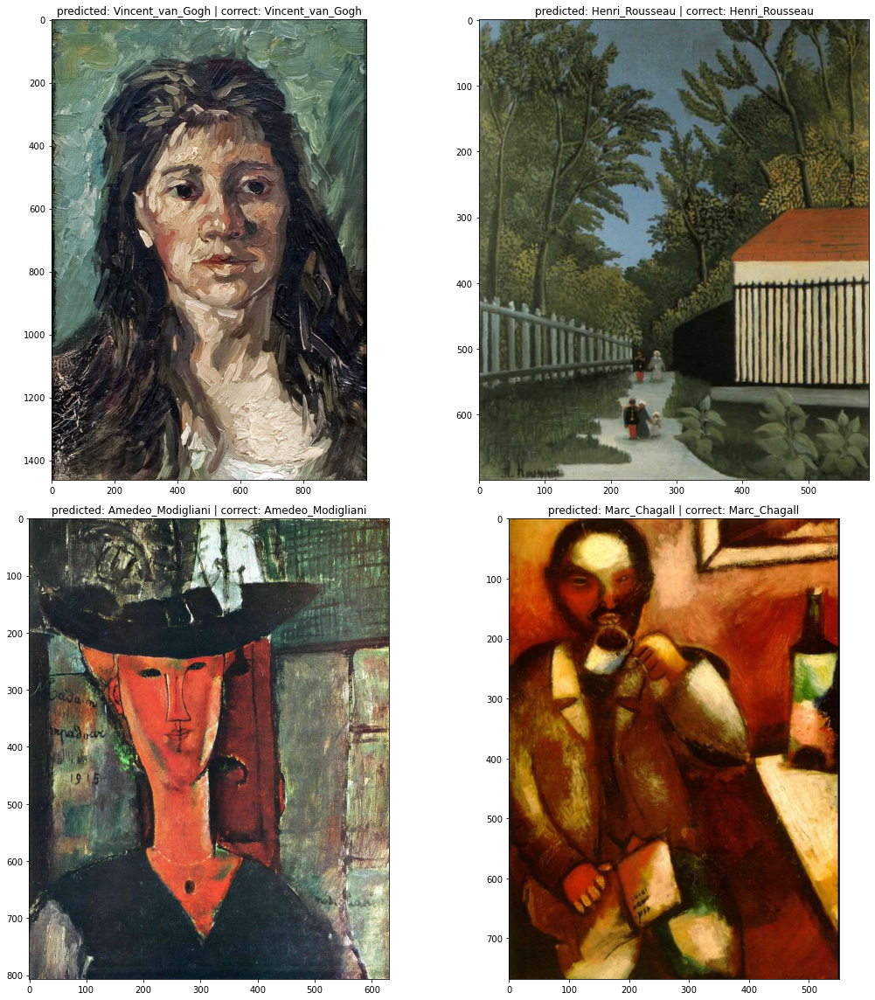

In [36]:
device = utils.get_device()
titles, images = list(zip(*read_random_images(ALL_IMAGES)))
titles = list(map(lambda x: x.rsplit(":")[0], titles))
show_prediction(model, class_names=class_names, titles=titles, images=images, device=device)


Additionally with SupervisedRunner, you can easily predict entire loader with only one method call. <br/>
The resulting object has shape = (number of elements in the loader, output shape from the model)

In [107]:
prediction_gen = runner.predict_loader(loader=loaders["valid"])
prediction = next(prediction_gen)['logits']

print("logits: ", prediction[0])

probabilities = torch.softmax(prediction[0], dim=0)
print("probabilities: ", probabilities)

label = probabilities.argmax().item()
print(f"predicted: {class_names[label]}")

logits:  tensor([ 2.3035, -0.6778, -2.6538, -0.9872, -3.4309, -2.8134, -5.0037, -2.7250,
        -5.6914, -5.6148, -3.2587, -3.7820, -5.7928, -5.9744, -8.7312,  0.6931,
        -4.6631, -4.4140, -2.1030,  1.1906, -3.4073, -3.7878, -5.8876, -4.6102,
        -3.5740, -6.0608, -3.0074, -2.0957,  0.1165,  5.1304, -3.1521, -6.9637,
        -1.2160,  4.6659, -7.1540, -1.8732,  0.9826, -5.1034, -4.2443, -3.8542,
        -2.6464, -8.1774, -3.7968, -4.0088, -0.6327, -4.3523, -5.7515, -5.6760,
        -1.2224,  0.7044], device='cuda:0')
probabilities:  tensor([3.3412e-02, 1.6950e-03, 2.3495e-04, 1.2439e-03, 1.0802e-04, 2.0030e-04,
        2.2410e-05, 2.1882e-04, 1.1266e-05, 1.2164e-05, 1.2832e-04, 7.6035e-05,
        1.0180e-05, 8.4892e-06, 5.3905e-07, 6.6760e-03, 3.1504e-05, 4.0416e-05,
        4.0756e-04, 1.0979e-02, 1.1060e-04, 7.5599e-05, 9.2594e-06, 3.3217e-05,
        9.3619e-05, 7.7865e-06, 1.6499e-04, 4.1057e-04, 3.7506e-03, 5.6443e-01,
        1.4276e-04, 3.1566e-06, 9.8954e-04, 3.5474e

## Model tracing

Catalyst allows you to use Runner to make [tracing](https://pytorch.org/docs/stable/jit.html) models.

> How to do this in the Config API, we wrote in [our blog (issue \#2)](https://github.com/catalyst-team/catalyst-info#catalyst-info-2-tracing-with-torchjit)

For this purpose it is necessary to pass in a method `trace ` model and a batch on which `predict_batch ` will be executed:

In [110]:
model

EfficientNet(
  (_conv_stem): Conv2dStaticSamePadding(
    3, 32, kernel_size=(3, 3), stride=(2, 2), bias=False
    (static_padding): ZeroPad2d(padding=(0, 1, 0, 1), value=0.0)
  )
  (_bn0): BatchNorm2d(32, eps=0.001, momentum=0.010000000000000009, affine=True, track_running_stats=True)
  (_blocks): ModuleList(
    (0): MBConvBlock(
      (_depthwise_conv): Conv2dStaticSamePadding(
        32, 32, kernel_size=(3, 3), stride=[1, 1], groups=32, bias=False
        (static_padding): ZeroPad2d(padding=(1, 1, 1, 1), value=0.0)
      )
      (_bn1): BatchNorm2d(32, eps=0.001, momentum=0.010000000000000009, affine=True, track_running_stats=True)
      (_se_reduce): Conv2dStaticSamePadding(
        32, 8, kernel_size=(1, 1), stride=(1, 1)
        (static_padding): Identity()
      )
      (_se_expand): Conv2dStaticSamePadding(
        8, 32, kernel_size=(1, 1), stride=(1, 1)
        (static_padding): Identity()
      )
      (_project_conv): Conv2dStaticSamePadding(
        32, 16, kernel_size=

In [109]:
from catalyst.utils.tracing import trace_model
batch = next(iter(loaders["valid"]))
# saves to `logdir` and returns a `ScriptModule` class
# runner.trace(model=model, batch=batch, logdir=logdir, fp16=is_fp16_used)
trace_model(model=model, batch=batch)

!ls {logdir}/trace/

AttributeError: 'dict' object has no attribute 'dim'

After this, you can easily load the model and predict anything!

In [ ]:
if is_fp16_used:
    model = utils.load_traced_model(f"{logdir}/trace/traced-forward-opt_O1.pth", device="cuda", opt_level="O1")
else:
    model = utils.load_traced_model(f"{logdir}/trace/traced-forward.pth", device="cpu")

In [ ]:
model_input = batch["features"].to("cuda" if is_fp16_used else "cpu")
model.forward(model_input)

### Advanced: Custom Callbacks

Let's count the number of predicted labels per class.

In [112]:
import collections

# from catalyst.dl import Callback, CallbackOrder, RunnerState
from catalyst.core.callback import Callback
from catalyst.core.callback import CallbackOrder
from catalyst.dl.core import RunnerState

class CustomInferCallback(Callback):
    def __init__(self):
        super().__init__(CallbackOrder.Internal)
        self.class_counts = collections.defaultdict(lambda: 0)

    def on_loader_start(self, state: RunnerState):
        self.class_counts = collections.defaultdict(lambda: 0)

    def on_batch_end(self, state: RunnerState):
        # data from the Dataloader
        # features, targets = state.input["features"], state.input["targets"]
        logits = state.output["logits"]

        labels = logits.argmax(axis=1)
        labels = labels.cpu().detach().numpy().tolist()
        for label in labels:
            self.class_counts[label] += 1

ModuleNotFoundError: No module named 'catalyst.dl.core'

In [ ]:
from collections import OrderedDict
from catalyst.dl.callbacks import CheckpointCallback

infer_loaders = {"infer": loaders["valid"]}
model = get_model(model_name, num_classes)

device = utils.get_device()
if is_fp16_used:
    fp16_params = dict(opt_level="O1") # params for FP16
else:
    fp16_params = None

runner = SupervisedRunner(device=device)
runner.infer(
    model=model,
    loaders=infer_loaders,
    callbacks=OrderedDict([
        ("loader", CheckpointCallback(resume=f"{logdir}/checkpoints/best.pth")),
        ("infer", CustomInferCallback())
    ]),
    fp16=fp16_params,
)

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
%matplotlib inline

class_counts = runner.callbacks["infer"].class_counts
counts = [class_counts[x] for x in range(len(class_names))]

plt.figure(figsize=(20, 9))
x = np.arange(len(counts))
plt.bar(x + 0.5, height=counts)
plt.xticks(x - 0.3, class_names, rotation=65)
plt.show()

### Advanced: Training with Focal Loss and OneCycle

In the `catalyst.contrib` there are a large number of different additional criterions, models, layers etc

For example,

[catalyst.contrib.criterion](https://catalyst-team.github.io/catalyst/api/contrib.html#module-catalyst.contrib.criterion.ce):
- HuberLoss
- CenterLoss
- FocalLossMultiClass
- DiceLoss / BCEDiceLoss
- IoULoss / BCEIoULoss
- LovaszLossBinary / LovaszLossMultiClass / LovaszLossMultiLabel
- WingLoss

Lr scheduler in [catalyst.contrib.schedulers](https://catalyst-team.github.io/catalyst/api/contrib.html#module-catalyst.contrib.schedulers.base):
- OneCycleLRWithWarmup

Moreover, in [catalyst.contrib.models](https://catalyst-team.github.io/catalyst/api/contrib.html#models) you can find various models for segmentation:
- Unet / ResnetUnet
- Linknet / ResnetLinknet
- FPNUnet / ResnetFPNUnet
- PSPnet / ResnetPSPnet
- MobileUnet


Finally, several handwritten modules in [catalyst.contrib.modules](https://catalyst-team.github.io/catalyst/api/contrib.html#module-catalyst.contrib.modules.common):
- Flatten
- TemporalAttentionPooling
- LamaPooling
- NoisyLinear
- GlobalAvgPool2d / GlobalMaxPool2d
- GlobalConcatPool2d / GlobalAttnPool2d

a bunch of others


But for now, let's take `FocalLoss` and `OneCycleLRWithWarmup` to play around.

In [ ]:
from catalyst.contrib.criterion import FocalLossMultiClass
from catalyst.contrib.schedulers import OneCycleLRWithWarmup

logdir = "./logs/classification_tutorial_1"
num_epochs = 10

model = get_model(model_name, num_classes)

criterion = FocalLossMultiClass()
optimizer = torch.optim.Adam(model.parameters(), lr=0.0003)
scheduler = OneCycleLRWithWarmup(
    optimizer, 
    num_steps=num_epochs, 
    lr_range=(0.001, 0.0001),
    warmup_steps=1
)

# FocalLoss expects one_hot for the input
# in our Reader function we have already created the conversion of targets in one_hot
# so, all we need - respecify the target key name
runner = SupervisedRunner(input_target_key="targets_one_hot")

In [ ]:
runner.train(
    model=model,
    criterion=criterion,
    optimizer=optimizer,
    scheduler=scheduler,
    loaders=loaders,
    callbacks=[
        AccuracyCallback(num_classes=num_classes),
        AUCCallback(
            num_classes=num_classes,
            input_key="targets_one_hot",
            class_names=class_names
        ),
        F1ScoreCallback(
            input_key="targets",
            activation="Softmax"
        )
    ],
    logdir=logdir,
    num_epochs=num_epochs,
    main_metric="auc/_mean",
    minimize_metric=False,
    fp16=fp16_params,
    verbose=True
)

In [ ]:
# it can take a while (colab issue)
utils.plot_metrics(
    logdir=logdir, 
    metrics=["loss", "accuracy01", "auc/_mean", "f1_score", "_base/lr"]
)

In [ ]:
device = utils.get_device()
titles, images = list(zip(*read_random_images(ALL_IMAGES)))
titles = list(map(lambda x: x.rsplit(":")[0], titles))
show_prediction(model, class_names=class_names, titles=titles, images=images, device=device)

### Advanced:  Balancing classes in the dataset

There are several useful data-sampler implementations in the `catalyst.data.sampler`. For example,
- `BalanceClassSampler` allows you to create stratified sampling on an unbalanced dataset. <br/> A strategy can be either downsampling, upsampling or some prespeficied number of samples per class. <br/> Very important feature for every classification problem.
- `MiniEpochSampler` allows you to split your "very large dataset" and sample some small portion of it every epoch. <br/> This is useful for those cases where you need to check valid metrics and save checkpoints more often. <br/> For example, your 1M images dataset can be sampled in 100k per epoch with all necessary metrics.

In [ ]:
from catalyst.data.sampler import BalanceClassSampler

logdir = "./logs/classification_tutorial_2"
num_epochs = 10

labels = [x["label"] for x in train_data]
sampler = BalanceClassSampler(labels, mode="upsampling")

# let's re-create our loaders with BalanceClassSampler
loader = get_loaders(open_fn, train_data_transforms, valid_data_transforms, sampler=sampler)

model = get_model(model_name, num_classes)

criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.0003)
scheduler = OneCycleLRWithWarmup(
    optimizer, 
    num_steps=num_epochs, 
    lr_range=(0.001, 0.0001),
    warmup_steps=1
)

runner = SupervisedRunner()

In [ ]:
runner.train(
    model=model,
    criterion=criterion,
    optimizer=optimizer,
    scheduler=scheduler,
    loaders=loaders,
    callbacks=[
        AccuracyCallback(num_classes=num_classes),
        AUCCallback(
            num_classes=num_classes,
            input_key="targets_one_hot",
            class_names=class_names
        ),
        F1ScoreCallback(
            input_key="targets",
            activation="Softmax"
        )
    ],
    logdir=logdir,
    num_epochs=num_epochs,
    main_metric="auc/_mean",
    minimize_metric=False,
    fp16=fp16_params,
    verbose=True
)

In [ ]:
# it can take a while (colab issue)
utils.plot_metrics(
    logdir=logdir, 
    metrics=["loss", "accuracy01", "auc/_mean", "f1_score", "_base/lr"]
)

In [ ]:
device = utils.get_device()
titles, images = list(zip(*read_random_images(ALL_IMAGES)))
titles = list(map(lambda x: x.rsplit(":")[0], titles))
show_prediction(model, class_names=class_names, titles=titles, images=images, device=device)